# **Capstone Project Module 2 - Boston Crime Analysis**

# Context
Crime incident reports are provided by Boston Police Department (BPD) to document the initial details surrounding an incident to which BPD officers respond. This is a dataset containing records from the new crime incident report system, which includes a reduced set of fields focused on capturing the type of incident as well as when and where it occurred.

## Problem statement
The police want to know **which areas are prone to crime, and would also like to know what type of crimes and when it happened.**
This information will greatly help the police to respond to a malicious incident in the neighborhood.

# Data

In [1]:
# Imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
import datetime
import folium
from folium.plugins import HeatMap
from scipy.stats import normaltest, chi2_contingency, mannwhitneyu, ttest_ind

import warnings
warnings.filterwarnings("ignore")

This dataset contains information related to the location, time, and crimes that have occurred and are included in the police reports. There are 17 columns in the crime dataset, namely:  

* INCIDENT_NUMBER: It is a unique number given each case. (unique incident number is not equal total incident number because some cases include lots of crime type, some of them have been shown below) #data.INCIDENT_NUMBER.nunique() :282517 (As you can see above, just 88.5% is a unique number in this column.)
* OFFENSE_CODE: It shows type of crime, also we have another list explain of each of them. (Because of existing Offense Code Group, it will be not used in the analysis.)
* OFFENSE_CODE_GROUP: The general name of each crime type.
* OFFENSE_DESCRIPTION: Explanation of specific crime. (It can be useful for further investigation)
* DISTRICT: Code of zone that crime happened. (Because of code is meaningless, it will be changed with name of district)
* REPORTING_AREA: Area number that crime reported.
* SHOOTING: If the crime included shooting, it shows with 'Y'.
* OCCURRED_ON_DATE: It shows exact time of crime. (year, month, day and time)
* YEAR: 2015,2016,2017,2018
* MONTH: the month that crime happened.
* DAY OF WEEK: the week that crime happened.
* HOUR: the hour that crime happened.
* UCR_PART: Uniform Crime Reporting Offence types that is defined by The Federal Bureau of Investigation for reporting data on crimes.
* STREET: the street name that crime happened
* LAT: the location latitude that crime happened.
* LONG: the location longitude that crime happened.
* LOCATION: the location latitude and longitude together that crime happened.


Here are the top 5 and bottom rows of the crime dataset.

In [2]:
df_crime = pd.read_csv('./crime.csv', encoding='latin-1')
display(df_crime.head(), df_crime.tail())

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
0,I182070945,619,Larceny,LARCENY ALL OTHERS,D14,808,NaN,2018-09-02 13:00:00,2018,9,Sunday,13,Part One,LINCOLN ST,42.357791,-71.139371,"(42.35779134, -71.13937053)"
1,I182070943,1402,Vandalism,VANDALISM,C11,347,NaN,2018-08-21 00:00:00,2018,8,Tuesday,0,Part Two,HECLA ST,42.306821,-71.060300,"(42.30682138, -71.06030035)"
2,I182070941,3410,Towed,TOWED MOTOR VEHICLE,D4,151,NaN,2018-09-03 19:27:00,2018,9,Monday,19,Part Three,CAZENOVE ST,42.346589,-71.072429,"(42.34658879, -71.07242943)"
3,I182070940,3114,Investigate Property,INVESTIGATE PROPERTY,D4,272,NaN,2018-09-03 21:16:00,2018,9,Monday,21,Part Three,NEWCOMB ST,42.334182,-71.078664,"(42.33418175, -71.07866441)"
4,I182070938,3114,Investigate Property,INVESTIGATE PROPERTY,B3,421,NaN,2018-09-03 21:05:00,2018,9,Monday,21,Part Three,DELHI ST,42.275365,-71.090361,"(42.27536542, -71.09036101)"


,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
319068,I050310906-00,3125,Warrant Arrests,WARRANT ARREST,D4,285,NaN,2016-06-05 17:25:00,2016,6,Sunday,17,Part Three,COVENTRY ST,42.336951,-71.085748,"(42.33695098, -71.08574813)"
319069,I030217815-08,111,Homicide,"MURDER, NON-NEGLIGIENT MANSLAUGHTER",E18,520,NaN,2015-07-09 13:38:00,2015,7,Thursday,13,Part One,RIVER ST,42.255926,-71.123172,"(42.25592648, -71.12317207)"
319070,I030217815-08,3125,Warrant Arrests,WARRANT ARREST,E18,520,NaN,2015-07-09 13:38:00,2015,7,Thursday,13,Part Three,RIVER ST,42.255926,-71.123172,"(42.25592648, -71.12317207)"
319071,I010370257-00,3125,Warrant Arrests,WARRANT ARREST,E13,569,NaN,2016-05-31 19:35:00,2016,5,Tuesday,19,Part Three,NEW WASHINGTON ST,42.302333,-71.111565,"(42.30233307, -71.11156487)"
319072,142052550,3125,Warrant Arrests,WARRANT ARREST,D4,903,NaN,2015-06-22 00:12:00,2015,6,Monday,0,Part Three,WASHINGTON ST,42.333839,-71.080290,"(42.33383935, -71.08029038)"


## Data Understanding and Cleaning
Before entering into the analysis, we need to get to know our dataset further in the *data understanding* stage. From this process, we will know what anomalies are contained in our dataset and need to be handled in the *data cleaning* stage. Every anomaly handling carried out will be accompanied by justification for the steps taken, both in domain knowledge and statistically.

First, let's look at the information from the crime dataset.

In [3]:
print(f'The number of rows and columns in the df dataset is {df_crime.shape}')
df_crime.info()

The number of rows and columns in the df dataset is (319073, 17)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 319073 entries, 0 to 319072
Data columns (total 17 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   INCIDENT_NUMBER      319073 non-null  object 
 1   OFFENSE_CODE         319073 non-null  int64  
 2   OFFENSE_CODE_GROUP   319073 non-null  object 
 3   OFFENSE_DESCRIPTION  319073 non-null  object 
 4   DISTRICT             317308 non-null  object 
 5   REPORTING_AREA       319073 non-null  object 
 6   SHOOTING             1019 non-null    object 
 7   OCCURRED_ON_DATE     319073 non-null  object 
 8   YEAR                 319073 non-null  int64  
 9   MONTH                319073 non-null  int64  
 10  DAY_OF_WEEK          319073 non-null  object 
 11  HOUR                 319073 non-null  int64  
 12  UCR_PART             318983 non-null  object 
 13  STREET               308202 non-null  object 
 14  Lat

In [4]:
display(df_crime.describe().T, df_crime.describe(include='object').T)

,count,mean,std,min,25%,50%,75%,max
OFFENSE_CODE,319073.0,2317.546956,1185.285543,111.000000,1001.000000,2907.000000,3201.000000,3831.000000
YEAR,319073.0,2016.560586,0.996344,2015.000000,2016.000000,2017.000000,2017.000000,2018.000000
MONTH,319073.0,6.609719,3.273691,1.000000,4.000000,7.000000,9.000000,12.000000
HOUR,319073.0,13.118205,6.294205,0.000000,9.000000,14.000000,18.000000,23.000000
Lat,299074.0,42.214381,2.159766,-1.000000,42.297442,42.325538,42.348624,42.395042
Long,299074.0,-70.908272,3.493618,-71.178674,-71.097135,-71.077524,-71.062467,-1.000000


,count,unique,top,freq
INCIDENT_NUMBER,319073,282517,I162030584,13
OFFENSE_CODE_GROUP,319073,67,Motor Vehicle Accident Response,37132
OFFENSE_DESCRIPTION,319073,244,SICK/INJURED/MEDICAL - PERSON,18783
DISTRICT,317308,12,B2,49945
REPORTING_AREA,319073,879,,20250
SHOOTING,1019,1,Y,1019
OCCURRED_ON_DATE,319073,233229,2017-06-01 00:00:00,29
DAY_OF_WEEK,319073,7,Friday,48495
UCR_PART,318983,4,Part Three,158553
STREET,308202,4657,WASHINGTON ST,14194


In [5]:
pd.set_option('display.max_colwidth', -1)
# Unique data for each column
listItem = []
for col in df_crime.columns :
    listItem.append( [col, df_crime[col].nunique(), df_crime[col].unique()])

tabel1Desc = pd.DataFrame(columns=['Column Name', 'Number of Unique', 'Unique Sample'],
                     data=listItem)
tabel1Desc

,Column Name,Number of Unique,Unique Sample
0,INCIDENT_NUMBER,282517,"[I182070945, I182070943, I182070941, I182070940, I182070938, I182070936, I182070933, I182070932, I182070931, I182070929, I182070928, I182070927, I182070923, I182070922, I182070921, I182070920, I182070919, I182070918, I182070917, I182070915, I182070913, I182070911, I182070910, I182070909, I182070908, I182070906, I182070905, I182070904, I182070903, I182070901, I182070900, I182070898, I182070897, I182070895, I182070893, I182070892, I182070891, I182070890, I182070889, I182070888, I182070887, I182070886, I182070885, I182070882, I182070881, I182070880, I182070879, I182070877, I182070876, I182070875, I182070874, I182070873, I182070872, I182070871, I182070870, I182070868, I182070866, I182070865, I182070863, I182070862, I182070861, I182070860, I182070859, I182070858, I182070857, I182070856, I182070855, I182070854, I182070852, I182070851, I182070850, I182070849, I182070847, I182070846, I182070844, I182070843, I182070842, I182070841, I182070840, I182070839, I182070838, I182070837, I182070836, I182070835, I182070834, I182070833, I182070832, I182070831, I182070830, I182070829, I182070828, I182070827, I182070826, I182070825, I182070824, I182070823, I182070822, I182070820, I182070819, I182070818, ...]"
1,OFFENSE_CODE,222,"[619, 1402, 3410, 3114, 3820, 724, 3301, 301, 3108, 2647, 3201, 3006, 3305, 614, 3801, 3803, 522, 3831, 802, 2007, 2900, 2907, 2629, 2662, 3207, 613, 3109, 2612, 1843, 3125, 1841, 3802, 3018, 2405, 617, 3625, 3106, 3501, 3115, 616, 3807, 1102, 1849, 2905, 1810, 1842, 1806, 1848, 1844, 423, 3205, 413, 1501, 3001, 3830, 561, 2914, 2610, 1109, 706, 2403, 3160, 900, 801, 3002, 520, 2648, 670, 615, 3116, 1504, 1830, 361, 2006, 311, 1001, 3810, 2401, 2646, 3821, 3811, 3007, 2660, 1831, 3119, 3170, 1874, 3112, 3502, 735, 612, 560, 381, 3402, 1815, 1107, 2101, 1106, 3202, 1503, ...]"
2,OFFENSE_CODE_GROUP,67,"[Larceny, Vandalism, Towed, Investigate Property, Motor Vehicle Accident Response, Auto Theft, Verbal Disputes, Robbery, Fire Related Reports, Other, Property Lost, Medical Assistance, Assembly or Gathering Violations, Larceny From Motor Vehicle, Residential Burglary, Simple Assault, Restraining Order Violations, Violations, Harassment, Ballistics, Property Found, Police Service Incidents, Drug Violation, Warrant Arrests, Disorderly Conduct, Property Related Damage, Missing Person Reported, Investigate Person, Fraud, Aggravated Assault, License Plate Related Incidents, Firearm Violations, Other Burglary, Arson, Bomb Hoax, Harbor Related Incidents, Counterfeiting, Liquor Violation, Firearm Discovery, Landlord/Tenant Disputes, Missing Person Located, Auto Theft Recovery, Service, Operating Under the Influence, Confidence Games, Search Warrants, License Violation, Commercial Burglary, HOME INVASION, Recovered Stolen Property, Offenses Against Child / Family, Prostitution, Evading Fare, Prisoner Related Incidents, Homicide, Embezzlement, Explosives, Criminal Harassment, Phone Call Complaints, Aircraft, Biological Threat, Manslaughter, Gambling, INVESTIGATE PERSON, HUMAN TRAFFICKING, HUMAN TRAFFICKING - INVOLUNTARY SERVITUDE, Burglary - No Property Taken]"
3,OFFENSE_DESCRIPTION,244,"[LARCENY ALL OTHERS, VANDALISM, TOWED MOTOR VEHICLE, INVESTIGATE PROPERTY, M/V ACCIDENT INVOLVING PEDESTRIAN - INJURY, AUTO THEFT, VERBAL DISPUTE, ROBBERY - STREET, FIRE REPORT - HOUSE, BUILDING, ETC., THREATS TO DO BODILY HARM, PROPERTY - LOST, SICK/INJURED/MEDICAL - PERSON, DEMONSTRATIONS/RIOT, LARCENY THEFT FROM MV - NON-ACCESSORY, M/V ACCIDENT - OTHER, M/V ACCIDENT - PERSONAL INJURY, BURGLARY - RESIDENTIAL - NO FORCE, M/V - LEAVING SCENE - PROPERTY DAMAGE, ASSAULT SIMPLE - BATTERY, VIOL. OF RESTRAINING ORDER W NO ARREST, VAL - VIOLATION OF AUTO LAW - OTHER, VAL - OPERATING AFTER REV/SUSP., HARASSMENT, BALLISTICS EVIDENCE/FOUND, PROPERTY - FOUND, LARCENY SHOPLIFTING, SERVICE TO OTHER PD INSIDE OF MA., FIRE REPORT/ALARM - FALSE, DRUGS - POSS CLASS B - INTENT TO MFR DIST DISP, WARRANT

In general, we can see that:
* Crime dataset has 17 columns and 319,073 rows
* Some columns, namely, `DISTRICT`, `SHOOTING`, `UCR_PART`, `STREET`, `Lat` and `Long` have empty data.
* From the observation of the `OCCURED_ON_DATE` data, we know that the empty `UCR_PART` may be lost due to the absence of data in 2015 for 6 months of the year and data in 2018 which did not exist for the last 3 months.
* `Location` data which does not have null but value will have anomaly when `Lat` and `Long` values ​​are null.

In [6]:
df_crime.isna().sum()

INCIDENT_NUMBER        0     
OFFENSE_CODE           0     
OFFENSE_CODE_GROUP     0     
OFFENSE_DESCRIPTION    0     
DISTRICT               1765  
REPORTING_AREA         0     
SHOOTING               318054
OCCURRED_ON_DATE       0     
YEAR                   0     
MONTH                  0     
DAY_OF_WEEK            0     
HOUR                   0     
UCR_PART               90    
STREET                 10871 
Lat                    19999 
Long                   19999 
Location               0     
dtype: int64

<AxesSubplot:>

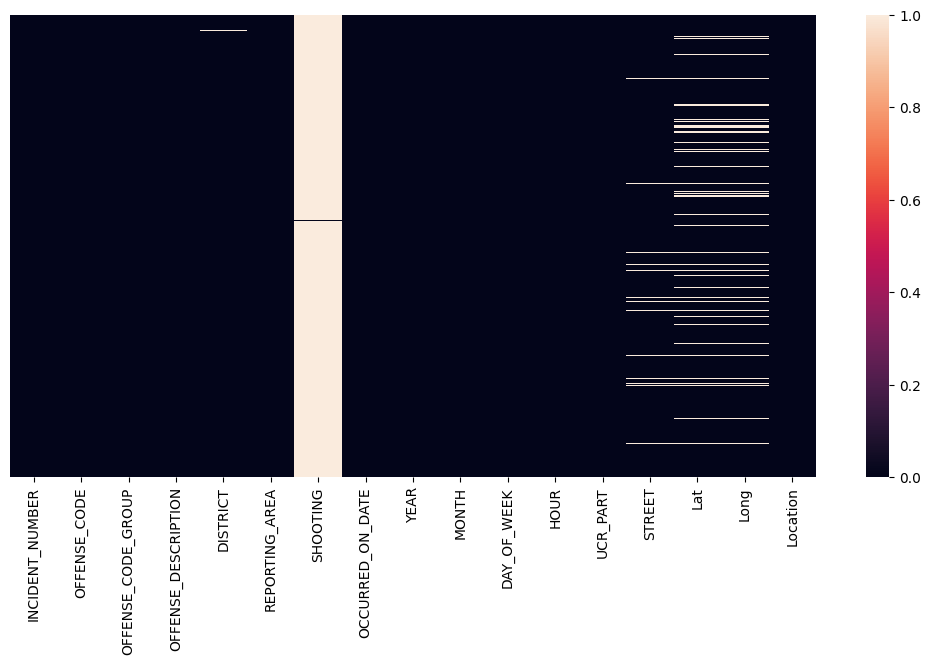

In [7]:
figure = plt.figure(figsize=(13,6))
sns.heatmap(df_crime.isnull(),yticklabels='')

Outline:
* *missing value* in the `DISTRICT`, `UCR_PART`, `STREET`, `Lat`, and `Long` columns has a fairly low proportion (<10%), but with a missing value in the `SHOOTING` column which reaches 99.7 %.
<hr>

* Renamed the columns to make it easier to call the feature.
* Some columns will be dropped because they are not used for this data analysis.
* Data from `OCCURED_ON_DATE` will be converted to datetime for analysis purposes.
* Empty data in the `SHOOTING` column can be filled with 'No' or no shooting incident and 'Y' becomes 'Yes', so that it is not only NaN.
* Lat/Long values ​​will be filled in because it will help the data analysis process, because some values ​​have empty data which will interfere with the coordinates.

### Rename Columns
Mengubah nama-nama kolum agar lebih mudah terbaca dan lebih mudah untuk pemanggilan nya.


In [8]:
rename = {
          'INCIDENT_NUMBER':'Incident_num',
          'OFFENSE_CODE_GROUP':'Group',
          'SHOOTING':'Shooting',
          'OFFENSE_DESCRIPTION':'Description',
          'REPORTING_AREA':'area',
          'DISTRICT':'District',
          'STREET':'Street',        
          'OCCURRED_ON_DATE':'Date',
          'YEAR':'Year',
          'MONTH':'Month',
          'DAY_OF_WEEK':'Day',
          'HOUR':'Hour',
          'STREET':'Street'}

df_crime.rename(index=str, columns=rename, inplace=True)

### Dropping Columns

In [9]:
# Remove unused columns
df_crime = df_crime.drop(['OFFENSE_CODE','UCR_PART','Location'], axis=1)

### Shooting
Sebelum memulai, mari kita mengisi data kosong di kolom `SHOOTING` dengan 'No' dan 'Y' menjadi 'Yes'

In [10]:
df_crime['Shooting'].value_counts()

Y    1019
Name: Shooting, dtype: int64

In [11]:
df_crime.loc[df_crime['Shooting']=='Y','Shooting']='Yes'

In [12]:
df_crime["Shooting"].fillna("No", inplace = True)

In [13]:
df_crime['Shooting'].value_counts()

No     318054
Yes    1019  
Name: Shooting, dtype: int64

In [14]:
df_crime['Shooting'].isna().sum()

0

### Date

* Changed `OCCURED_ON_DATE` column to datetime value.
* Changed `DAY_OF_WEEK` to categorical.

In [15]:
# Convert OCCURED_ON_DATE to datetime
df_crime['Date'] = pd.to_datetime(df_crime['Date'])

# Convert DAY_OF_WEEK to an ordered category
df_crime.Day = pd.Categorical(df_crime.Day, 
              categories=['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'],
              ordered=True)

In [16]:
df_crime['Day'].value_counts()

Friday       48495
Wednesday    46729
Thursday     46656
Tuesday      46383
Monday       45679
Saturday     44818
Sunday       40313
Name: Day, dtype: int64

## Cleaned Data

In [17]:
listItem = []
for col in df_crime.columns :
    listItem.append([col, df_crime[col].dtype, df_crime[col].isna().sum(),
                    df_crime[col].nunique(), list(df_crime[col].drop_duplicates().sample(2).values)]);

dfDesc = pd.DataFrame(columns=['dataFeatures', 'dataType', 'null', 'unique', 'uniqueSample'],
                     data=listItem)
print(df_crime.shape)
dfDesc

(319073, 14)


,dataFeatures,dataType,null,unique,uniqueSample
0,Incident_num,object,0,282517,"[I182042273, I162103972]"
1,Group,object,0,67,"[Violations, Explosives]"
2,Description,object,0,244,"[INVESTIGATE PROPERTY, FIREARM/WEAPON - POSSESSION OF DANGEROUS]"
3,District,object,1765,12,"[A1, B2]"
4,area,object,0,879,"[693, 109]"
5,Shooting,object,0,2,"[Yes, No]"
6,Date,datetime64[ns],0,233229,"[2017-12-02T17:20:00.000000000, 2015-11-12T18:36:00.000000000]"
7,Year,int64,0,4,"[2018, 2017]"
8,Month,int64,0,12,"[6, 5]"
9,Day,category,0,7,"[Sunday, Thursday]"


After the cleaning process, it can be seen that now we only use 14 feature columns from the 17 feature columns that are available.


# Data Analysis

## Number Of Crimes Activities By District

<AxesSubplot:xlabel='District', ylabel='count'>

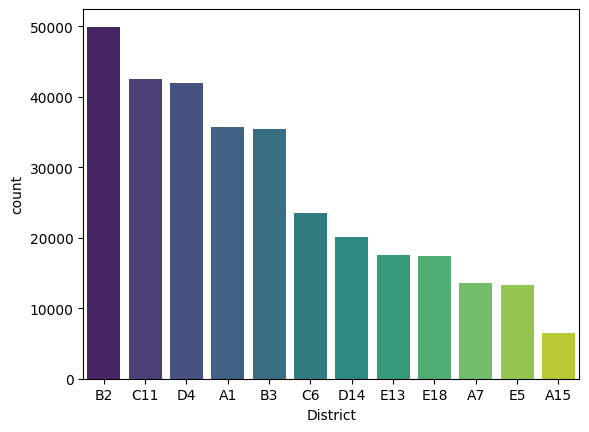

In [18]:
sns.countplot(x=df_crime['District'],palette='viridis', order=df_crime['District'].value_counts().index)

**We can see that district B2 has the highest crime rate, and district A15 has the lowest crime rate.**

## The Distribution of Crimes Committed By District.

<AxesSubplot:xlabel='Group', ylabel='count'>

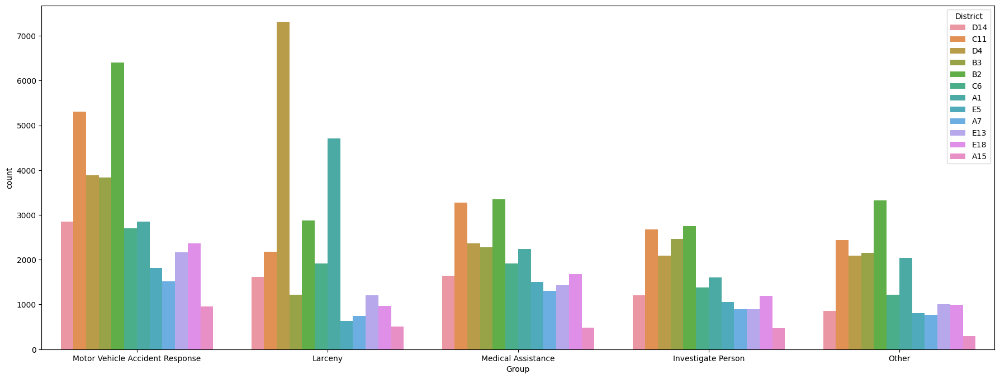

In [19]:
plt.figure(figsize=(22,8))
sns.countplot(data=df_crime, x='Group', hue='District', order=df_crime['Group'].value_counts().head().index)

**Here the highest crimes differ for each Districts.**

<br>
The top 5 crimes that spread on all the districts .
As for crimes, Motor Vehicle Accident Response, Larceny, Medical Assistance Group and Investigate Person are the most common ones.

## Crime Rates By Day

<AxesSubplot:xlabel='Day', ylabel='count'>

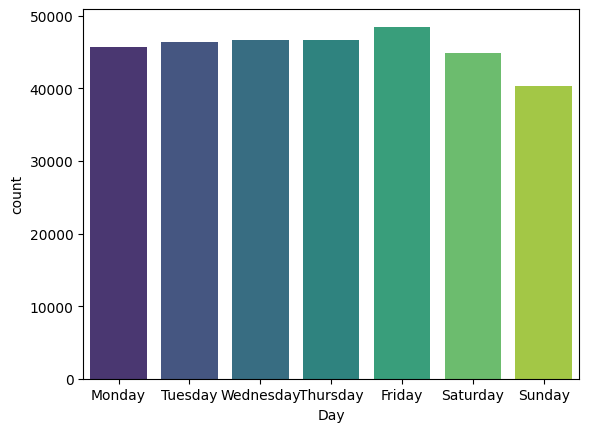

In [20]:
sns.countplot(data=df_crime, x='Day', palette='viridis')

**We can see that crime remains pretty consistent across the week, peaking (but not by much) on Friday, and reaching a minimum on Sunday. One idea why crime is lower on Sunday is because of church.**

<hr>

In [21]:
Number_crimes_days = df_crime['Day'].value_counts()
days = pd.DataFrame(data=Number_crimes_days.index, columns=["Day"])
days['values'] = Number_crimes_days.values

In [22]:
fig = px.histogram(df_crime, x="Day",color="Day")
fig.update_layout(
    title_text='Crime count on each day', 
    xaxis_title_text='Day',
    yaxis_title_text='Crimes Count', 
    bargap=0.2, 
    bargroupgap=0.1
)
fig.show()

In [23]:
fig = go.Figure(data=[go.Pie(labels=days['Day'], values=days['values'], hole=.4)])
fig.update_layout(
    title_text='Crime count on each day',
)
fig.show()

## Crime Rates By Hour

<AxesSubplot:xlabel='Hour', ylabel='count'>

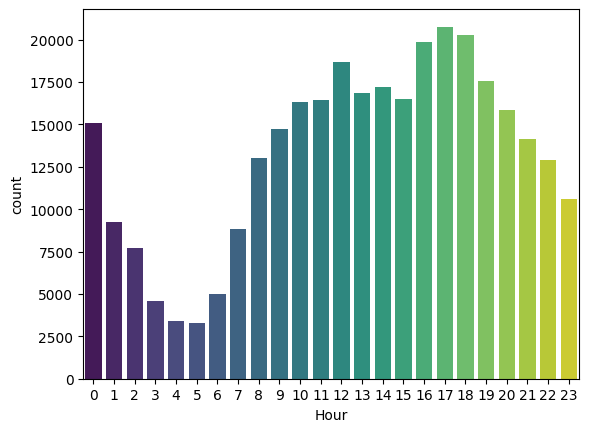

In [24]:
sns.countplot(x=df_crime['Hour'], palette='viridis')

<AxesSubplot:xlabel='Hour', ylabel='Density'>

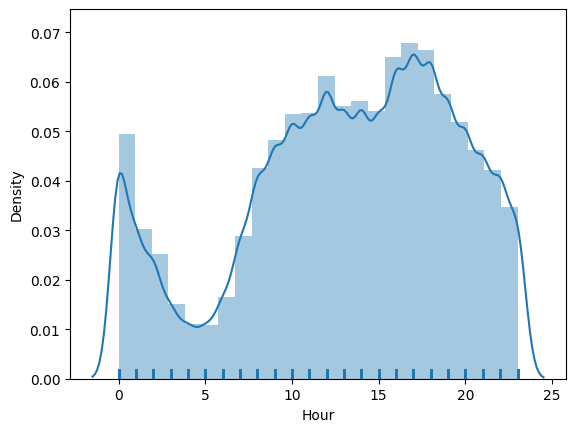

In [25]:
sns.distplot(df_crime['Hour'], bins=24, hist=True, rug=True)

In the early hours of the morning, crime quickly drops and reaches a minima at 4 or 5 AM, then clickly rising, reaching a local minima at noon and peaking at 5 PM. What is interesting is the sudden jump from the 23rd hour to the 24th/0th hour in crimes.

What is also interesting is that there appears to be more crimes committed during daylight than at night.

Using average Boston daylight hours of 6AM to 7PM, let's see how many crimes are commited for each section Day and Night.

In [26]:
def convert(hour):
    if hour > 6 and hour < 19:
        return 'Day'
    else:
        return 'Night'
df_crime['DAY_OR_NIGHT'] = df_crime['Hour'].apply(convert)

<AxesSubplot:xlabel='DAY_OR_NIGHT', ylabel='count'>

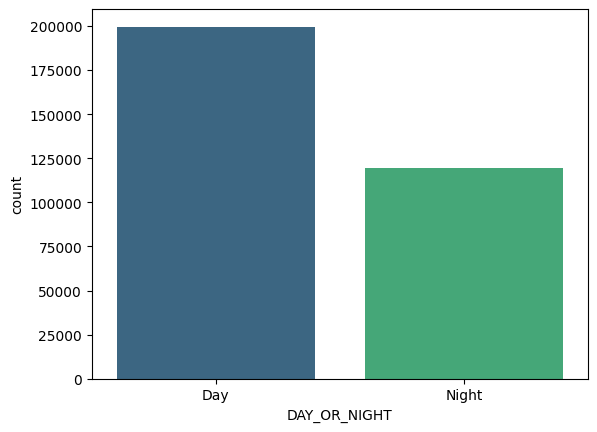

In [27]:
sns.countplot(x=df_crime['DAY_OR_NIGHT'], palette='viridis')

**It's confirmed that more crimes are done during the day than at night.**
<hr>

In [28]:
fig = px.histogram(df_crime, x='Hour', color='Hour')
fig.update_layout(
    title_text='Crime count on each Hour',
    xaxis_title_text='Hour', 
    yaxis_title_text='Count', 
    bargap=0.2, 
    bargroupgap=0.1
)
fig.show()

## Crime Rates By Month

<AxesSubplot:xlabel='Month', ylabel='count'>

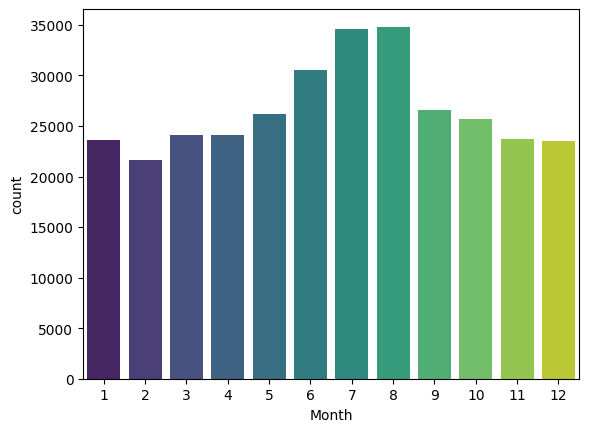

In [29]:
sns.countplot(x=df_crime['Month'],palette='viridis')

<hr>

In [30]:
Number_crimes_month = df_crime['Month'].value_counts()
months = pd.DataFrame(data=Number_crimes_month.index, columns=["Month"])
months['values'] = Number_crimes_month.values

In [31]:
fig = go.Figure(
        go.Bar(
            y=months['values'],
            x=months['Month'],
            marker=dict(
            color=months['Month'],
            ),
            orientation='v')
        )
fig.update_layout(
    title_text='Major Crimes in Boston per month', 
    xaxis_title_text='Month',
    yaxis_title_text='Count', 
    bargap=0.2, 
    bargroupgap=0.1
)
fig.show()

In [32]:
fig = px.histogram(df_crime, x='Year', color='Month')
fig.update_layout(
    title_text='Crime count on each year per month',
    xaxis_title_text='Year', 
    yaxis_title_text='Crimes Count', 
    bargap=0.2, 
    bargroupgap=0.1
)
fig.show()

There seems to be a swell in crimes during the summer months (rising quickly from May to June, then reaching a high at July and August). Soon after, it drops. A worthy explanation is the temperature difference - the warmer months encourage crime more than colder months.

## Crime Rates By Year

In [33]:
Number_crimes = df_crime['Group'].value_counts()
values = Number_crimes.values
categories = pd.DataFrame(data=Number_crimes.index, columns=["Group"])
categories['values'] = values

In [34]:
Number_crimes_year = df_crime['Year'].value_counts()
years = pd.DataFrame(data=Number_crimes_year.index, columns=["Year"])
years['values'] = Number_crimes_year.values

In [35]:
fig = px.pie(years, values='values', names='Year', 
color_discrete_sequence=px.colors.sequential.Burgyl)

fig.show()

Interesting - it seems that the amount of crime rose dramatically from 2015-2016, stayed high through 2016-2017, and dropped significantly in 2018.

## Major Crimes On Boston

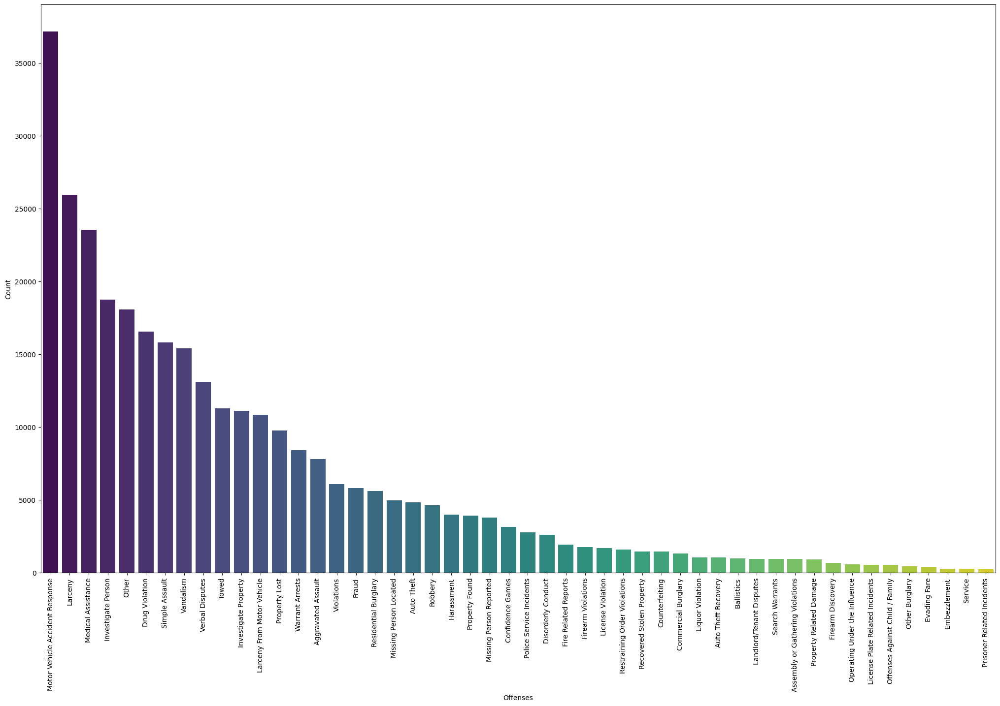

In [36]:
df2 = pd.DataFrame(columns = ['Offenses'])
df2["Offenses"] = [each for each in df_crime.Group.unique()]
df2["Count"] = [len(df_crime[df_crime.Group == each]) for each in df2.Offenses]
df2=df2.sort_values(by=['Count'],ascending=False)

plt.figure(figsize=(25,15))
sns.barplot(x=df2.Offenses.head(50), y=df2.Count.head(50), palette='viridis')
plt.xticks(rotation= 90)
plt.xlabel('Offenses')
plt.ylabel('Count')
plt.show()

### Top 10 Major Crimes

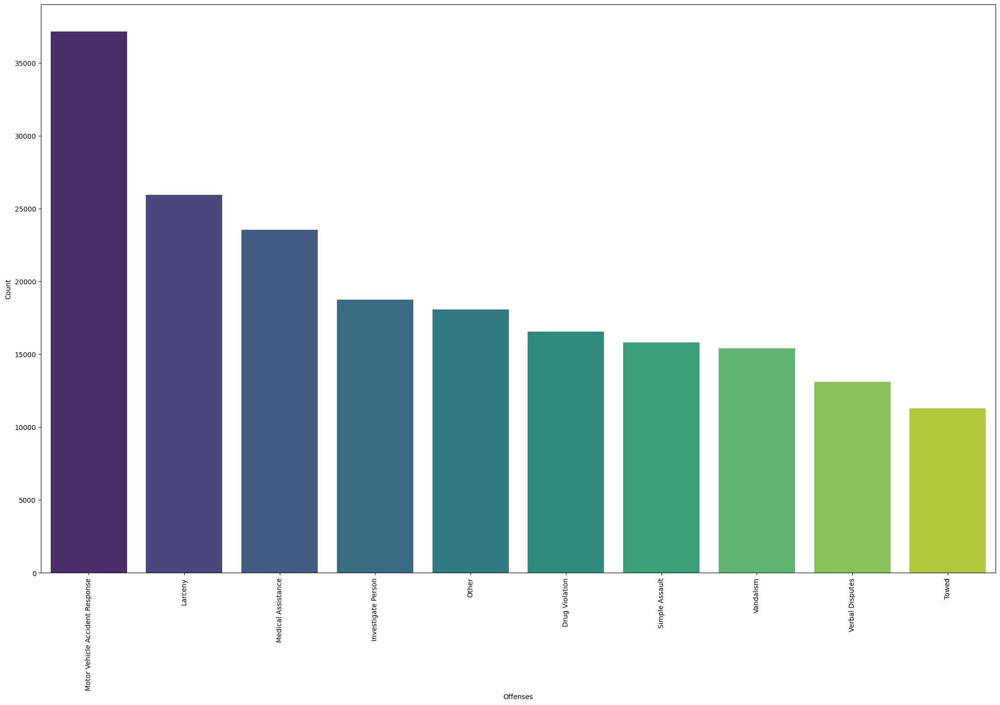

In [37]:
df2 = pd.DataFrame(columns = ['Offenses'])
df2["Offenses"] = [each for each in df_crime.Group.unique()]
df2["Count"] = [len(df_crime[df_crime.Group == each]) for each in df2.Offenses]
df2=df2.sort_values(by=['Count'],ascending=False)

plt.figure(figsize=(25,15))
sns.barplot(x=df2.Offenses.head(10), y=df2.Count.head(10), palette='viridis')
plt.xticks(rotation= 90)
plt.xlabel('Offenses')
plt.ylabel('Count')
plt.show()

<hr>

In [38]:
fig = px.histogram(df_crime, x='Group', color='Group')
fig.update_layout(
    title_text='Major Crimes On Boston',
    xaxis_title_text='Crime', 
    yaxis_title_text='Count', 
    bargap=0.2, 
    bargroupgap=0.1
)
fig.show()

In [44]:
df_crime['Group'].value_counts().head()

Motor Vehicle Accident Response    37132
Larceny                            25935
Medical Assistance                 23540
Investigate Person                 18754
Other                              18075
Name: Group, dtype: int64

## Map of Boston Crimes

### Major Criminal Incidents

In [39]:
ds = df_crime.dropna(subset = ['Lat','Long','District'])
ds = ds[ds['Group'] == 'Motor Vehicle Accident Response']
location = pd.DataFrame(data =(ds.groupby(["Lat","Long"]).count()[['Incident_num']]).reset_index().values, columns=["Lat","Long","Incident_num"])
x,y = location['Long'], location['Lat']
fig = px.density_mapbox(location,lat="Lat",lon="Long",z="Incident_num",radius=10,center=dict(lat=42.32475, lon=-71.076),zoom=10,mapbox_style="stamen-terrain",height=500,width=1100)
fig.show()

In [40]:
ds = df_crime.dropna(subset = ['Lat','Long','District'])
ds = ds[ds['Group'] == 'Larceny']
location = pd.DataFrame(data =(ds.groupby(["Lat","Long"]).count()[['Incident_num']]).reset_index().values, columns=["Lat","Long","Incident_num"])
x,y = location['Long'], location['Lat']
fig = px.density_mapbox(location,lat="Lat",lon="Long",z="Incident_num",radius=10,center=dict(lat=42.32475, lon=-71.076),zoom=10,mapbox_style="stamen-terrain",height=500,width=1100)
fig.show()

In [41]:
ds = df_crime.dropna(subset = ['Lat','Long','District'])
ds = ds[ds['Group'] == 'Medical Assistance']
location = pd.DataFrame(data =(ds.groupby(["Lat","Long"]).count()[['Incident_num']]).reset_index().values, columns=["Lat","Long","Incident_num"])
x,y = location['Long'], location['Lat']
fig = px.density_mapbox(location,lat="Lat",lon="Long",z="Incident_num",radius=10,center=dict(lat=42.32475, lon=-71.076),zoom=10,mapbox_style="stamen-terrain",height=500,width=1100)
fig.show()

### General distribution of crimes with heat map

In [42]:
crime_map = folium.Map(location=[42.3125,-71.0875], 
                      zoom_start = 11)

data_heatmap = df_crime[['Lat','Long']]
data_heatmap = df_crime.dropna(axis=0, subset=['Lat','Long'])
data_heatmap = [[row['Lat'],row['Long']] for index, row in data_heatmap.iterrows()]
HeatMap(data_heatmap, radius=10).add_to(crime_map)

crime_map

# Conclusions & Recommendations

## Conclusions

Several conclusions have been made with the analysis above, Well let's come to our question now and that is:
1. How has crime changed over the years?
    * When we look at the number of crimes committed by years, we see that there were fewer crimes in 2015 and 2018.There are 6 missing months in 2015 and 3 months for 2018. So, the significant decrease in this year is most probably cause by these missing values. If we look at it by filtering it according to the data we have in these months , we can say that the distribution of crimes by years is close.
    
    <br>
2. Is it possible to predict where or when a crime will be committed?
    * The most crimes seem to be on Friday. The months with the most crimes appear to be July and August (Crime Amount By Month chart), which coincides with the summer season in the Crime Amount By Season chart.
    * We see that the most crimes occur around 17: 00 , 18: 00 and 12: 00 . This may be because students / staff coincide with departure times and breaks. The number of crimes is likely to increase with the increasing number of people on the street.
    * From the graph above, we can say that the most crimes occur in the B2 district.
    * So, assuming that the next crimes follow the same pattern as the crimes in 2015-2018, based on our analysis, we can speculate which crime could be committed in which region in the future.

    <br>
3. What can you say about the distribution of different offenses over the city?
    * The most common crimes are motor vehicle accident and larceny.
    * We can say that larceny crime was mostly seen in the D4 district, and the crimes in the motor vehicle accident group were seen in the B2 district.
    * By looking at the heat map, we can speculate when crimes are concentrated in the city.
    * There is no homogeneous distribution over the Boston city. Crimes are most likely committed in the central areas.

## Recomendations

There are also few recomendations that have been made to make the Boston Police Departement to make an improvement for the near future. and that is:

1. Police Training

Police training to respond all crimes  that occurs in the hot-spots
<br> 

2. More Patrols

Crimes happens often in day, police needs to patrol more around hours that crimes tend to happen.
<br>

3. Location Reports

Police need to file a better pinpoint location of the crimes, so in the future they can predict better for the crimes that have happened.
<br> 

4. Control Hot-Spots

Focus more on the center of the city
